In [384]:
import pandas as pd
import matplotlib.pyplot as plt
import requests
from bs4 import BeautifulSoup
import sqlite3
import pickle
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
import numpy as np
import re
from itertools import product
import random
import time
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# XAI
import shap
import dice_ml
from dice_ml import Data, Model, Dice
from dice_ml.explainer_interfaces import dice_tensorflow2
from lime.lime_tabular import LimeTabularExplainer

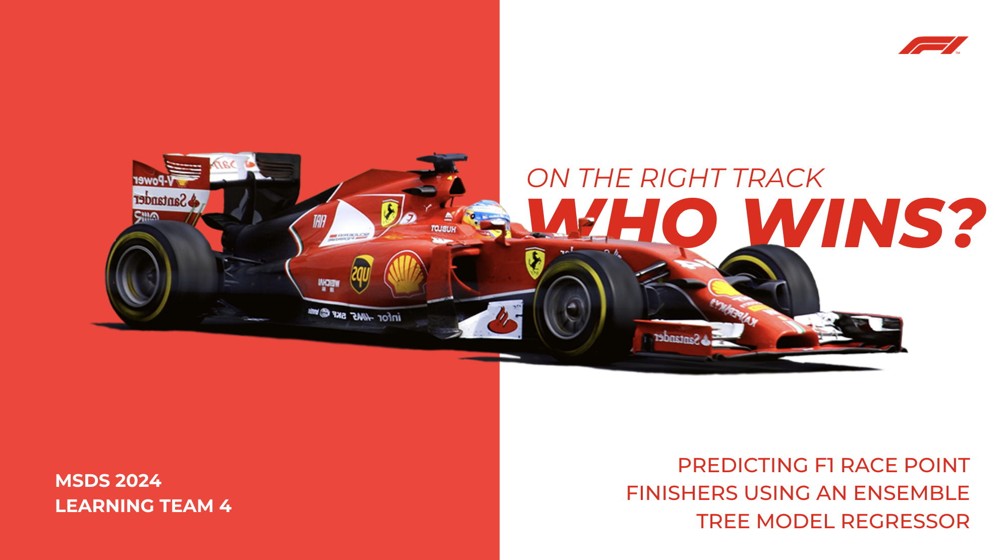

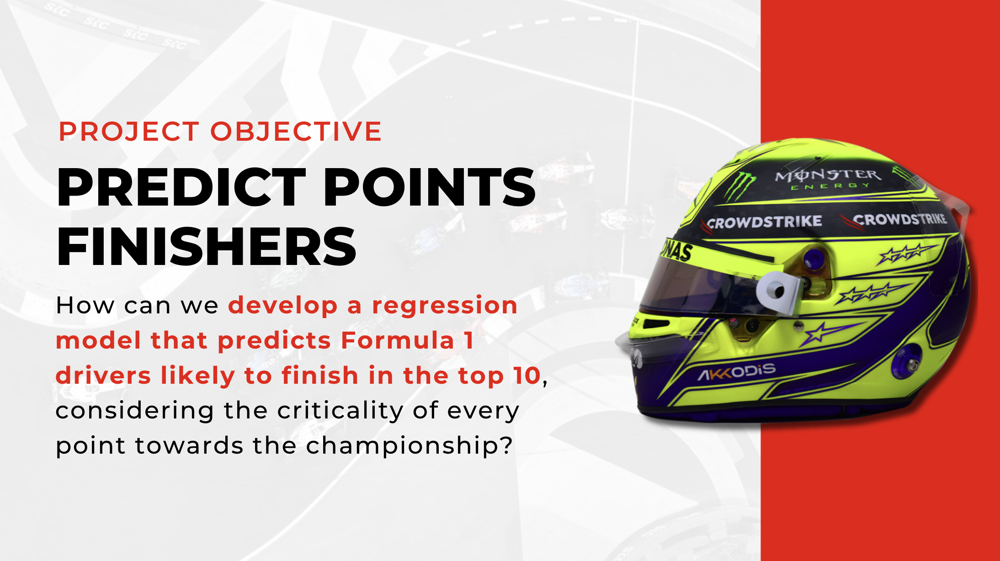

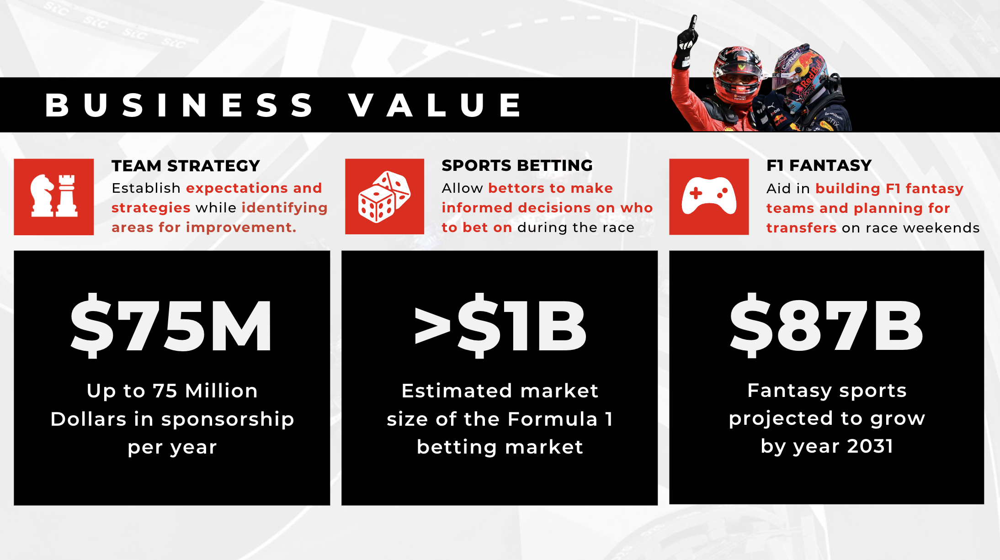

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">DATA COLLECTION</h1><a id='ExecSum'></a><a id='Title'></a><a

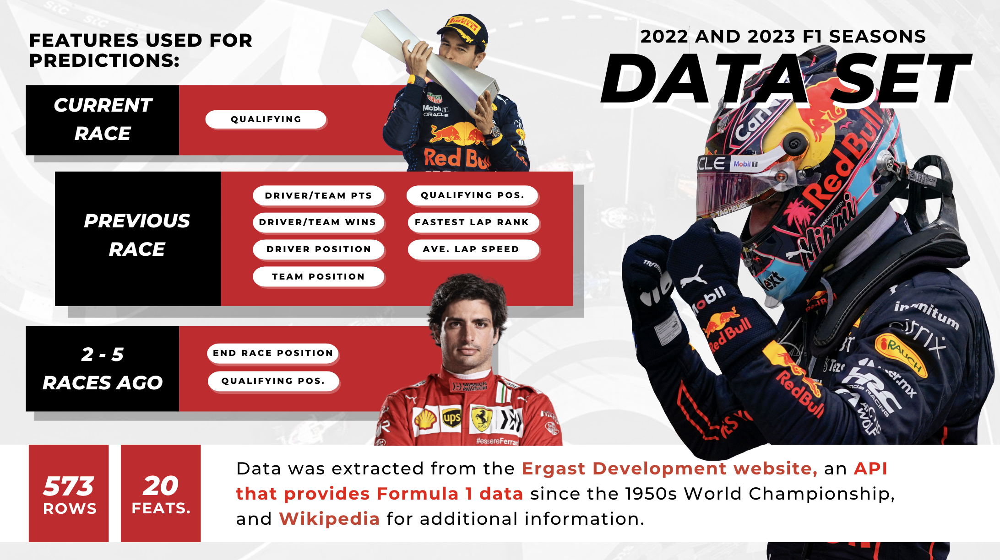

# **Connect to SQL Database**

In [17]:
conn = sqlite3.connect('formula_1.sql')

# **Retrieve Free Practice Data**

In [129]:
races_by_year = {
    '2022': [
        {"race_id": "1124/bahrain", "sessions": ['1', '2', '3'], 'race_name': 'Bahrain Grand Prix'},
        {"race_id": "1125/saudi-arabia", "sessions": ['1', '2', '3'], 'race_name': 'Saudi Arabian Grand Prix'},
        {"race_id": "1108/australia", "sessions": ['1', '2', '3'], 'race_name': 'Australian Grand Prix'},
        {"race_id": "1109/italy", "sessions": ['1', '2'], 'race_name': 'Emilia Romagna Grand Prix'},
        {"race_id": "1110/miami", "sessions": ['1', '2', '3'], 'race_name': 'Miami Grand Prix'},
        {"race_id": "1111/spain", "sessions": ['1', '2', '3'], 'race_name': 'Spanish Grand Prix'},
        {"race_id": "1112/monaco", "sessions": ['1', '2', '3'], 'race_name': 'Monaco Grand Prix'},
        {"race_id": "1126/azerbaijan", "sessions": ['1', '2', '3'], 'race_name': 'Azerbaijan Grand Prix'},
        {"race_id": "1113/canada", "sessions": ['1', '2', '3'], 'race_name': 'Canadian Grand Prix'},
        {"race_id": "1114/great-britain", "sessions": ['1', '2', '3'], 'race_name': 'British Grand Prix'},
        {"race_id": "1115/austria", "sessions": ['1', '2'], 'race_name': 'Austrian Grand Prix'},
        {"race_id": "1116/france", "sessions": ['1', '2', '3'], 'race_name': 'French Grand Prix'},
        {"race_id": "1117/hungary", "sessions": ['1', '2', '3'], 'race_name': 'Hungarian Grand Prix'},
        {"race_id": "1118/belgium", "sessions": ['1', '2', '3'], 'race_name': 'Belgian Grand Prix'},
        {"race_id": "1119/netherlands", "sessions": ['1', '2', '3'], 'race_name': 'Dutch Grand Prix'},
        {"race_id": "1120/italy", "sessions": ['1', '2', '3'], 'race_name': 'Italian Grand Prix'},
        {"race_id": "1133/singapore", "sessions": ['1', '2', '3'], 'race_name': 'Singapore Grand Prix'},
        {"race_id": "1134/japan", "sessions": ['1', '2', '3'], 'race_name': 'Japanese Grand Prix'},
        {"race_id": "1135/united-states", "sessions": ['1', '2', '3'], 'race_name': 'United States Grand Prix'},
        {"race_id": "1136/mexico", "sessions": ['1', '2', '3'], 'race_name': 'Mexico City Grand Prix'},
        {"race_id": "1137/brazil", "sessions": ['1', '2'], 'race_name': 'Brazilian Grand Prix'},
        {"race_id": "1138/abu-dhabi", "sessions": ['1', '2', '3'], 'race_name': 'Abu Dhabi Grand Prix'}
    ],
    '2023': [
        {"race_id": "1141/bahrain", "sessions": ['1', '2', '3'], 'race_name': 'Bahrain Grand Prix'},
        {"race_id": "1142/saudi-arabia", "sessions": ['1', '2', '3'], 'race_name': 'Saudi Arabian Grand Prix'},
        {"race_id": "1143/australia", "sessions": ['1', '2', '3'], 'race_name': 'Australian Grand Prix'},
        {"race_id": "1207/azerbaijan", "sessions": ['1'], 'race_name': 'Azerbaijan Grand Prix'},
        {"race_id": "1208/miami", "sessions": ['1', '2', '3'], 'race_name': 'Miami Grand Prix'},
        #{"race_id": "1209/italy", "sessions": ['1', '2', '3']},
        {"race_id": "1210/monaco", "sessions": ['1', '2', '3'], 'race_name': 'Monaco Grand Prix'},
        {"race_id": "1211/spain", "sessions": ['1', '2', '3'], 'race_name': 'Spanish Grand Prix'},
        {"race_id": "1212/canada", "sessions": ['1', '2', '3'], 'race_name': 'Canadian Grand Prix'},
        {"race_id": "1213/austria", "sessions": ['1'], 'race_name': 'Austrian Grand Prix'},
        {"race_id": "1214/great-britain", "sessions": ['1', '2', '3'], 'race_name': 'British Grand Prix'},
        {"race_id": "1215/hungary", "sessions": ['1', '2', '3'], 'race_name': 'Hungarian Grand Prix'},
        {"race_id": "1216/belgium", "sessions": ['1'], 'race_name': 'Belgian Grand Prix'},
        {"race_id": "1217/netherlands", "sessions": ['1', '2', '3'], 'race_name': 'Dutch Grand Prix'},
        {"race_id": "1218/italy", "sessions": ['1', '2', '3'], 'race_name': 'Italian Grand Prix'},
        {"race_id": "1219/singapore", "sessions": ['1', '2', '3'], 'race_name': 'Singapore Grand Prix'},
        {"race_id": "1220/japan", "sessions": ['1', '2', '3'], 'race_name': 'Japanese Grand Prix'},
        {"race_id": "1221/qatar", "sessions": ['1'], 'race_name': 'Qatar Grand Prix'},
        {"race_id": "1222/united-states", "sessions": ['1'], 'race_name': 'United States Grand Prix'},
        {"race_id": "1223/mexico", "sessions": ['1', '2', '3'], 'race_name': 'Mexico City Grand Prix'},
        {"race_id": "1224/brazil", "sessions": ['1'], 'race_name': 'Brazilian Grand Prix'},
        {"race_id": "1225/las-vegas", "sessions": ['1', '2', '3'], 'race_name': 'Las Vegas Grand Prix'},
        {"race_id": "1226/abu-dhabi", "sessions": ['1', '2', '3'], 'race_name': 'Abu Dhabi Grand Prix'}
    ]
}

def scrape_f1_results(url):
    """
    Scrape F1 results from a given URL for different years and races.
    
    Parameters
    ----------
    url: The base URL to fetch data from.
    
    Returns
    -------
    - A DataFrame containing the practice session results for all specified races.
    """
    all_results_df = pd.DataFrame()
    for year, races in races_by_year.items():
        for race in races:
            race_id_split, location = race["race_id"].split('/')
            for practice_session in race["sessions"]:
                full_url = f"{url}/{year}/races/{race_id_split}/{location}/practice-{practice_session}.html"
                try:
                    response = requests.get(full_url)
                    time.sleep(random.uniform(1, 3))
                    response.raise_for_status()
                    
                    html_content = response.text
                    soup = BeautifulSoup(html_content, 'html.parser')
                    
                    table = soup.find('table', class_='f1-table f1-table-with-data w-full')
                    if table:
                        rows = table.select('tbody tr')
                        columns = ['Year', 'Location', 'Session', 'Pos', 
                                   'No', 'Driver', 'Car', 'Time', 'Gap', 
                                   'Laps', 'Racename']
                        data = []
                        
                        for row in rows[1:]:
                            cols = row.select('td')
                            row_data = [col.get_text(strip=True) for col in cols]
                            row_data.insert(0, practice_session)
                            row_data.insert(0, location)
                            row_data.insert(0, year)
                            row_data.append(race['race_name'])
                            data.append(row_data)
                        
                        df = pd.DataFrame(data, columns=columns)
                        all_results_df = pd.concat([all_results_df, df], ignore_index=True)
                        print(f'{year}-{location}-practice{practice_session}', 'done')
                    else:
                        print(f"Table not found for {year}, {location}, Practice {practice_session}")
                except requests.exceptions.RequestException as e:
                    print(f"Request failed: {e}")
    return all_results_df
df_practice = scrape_f1_results('https://www.formula1.com/en/results.html')

2022-bahrain-practice1 done
2022-bahrain-practice2 done
2022-bahrain-practice3 done
2022-saudi-arabia-practice1 done
2022-saudi-arabia-practice2 done
2022-saudi-arabia-practice3 done
2022-australia-practice1 done
2022-australia-practice2 done
2022-australia-practice3 done
2022-italy-practice1 done
2022-italy-practice2 done
2022-miami-practice1 done
2022-miami-practice2 done
2022-miami-practice3 done
2022-spain-practice1 done
2022-spain-practice2 done
2022-spain-practice3 done
2022-monaco-practice1 done
2022-monaco-practice2 done
2022-monaco-practice3 done
2022-azerbaijan-practice1 done
2022-azerbaijan-practice2 done
2022-azerbaijan-practice3 done
2022-canada-practice1 done
2022-canada-practice2 done
2022-canada-practice3 done
2022-great-britain-practice1 done
2022-great-britain-practice2 done
2022-great-britain-practice3 done
2022-austria-practice1 done
2022-austria-practice2 done
2022-france-practice1 done
2022-france-practice2 done
2022-france-practice3 done
2022-hungary-practice1 do

In [130]:
df_all_practice = df_practice.copy()
df_all_practice['driverCode'] = df_all_practice['Driver'].str[-3:]
df_all_practice['driverName'] = df_all_practice['Driver'].str[:-3]
df_all_practice['Pos'] = pd.to_numeric(df_all_practice['Pos'])
df_all_practice['Session'] = pd.to_numeric(df_all_practice['Session'])
df_all_practice['Year'] = pd.to_numeric(df_all_practice['Year'])
df_all_practice.to_sql('freePracticeRanking', conn, if_exists='replace', index=False)

2191

# **Add All Data from Ergast API**

In [134]:
pd.read_csv('formula_one/circuits.csv').to_sql('circuits', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/constructor_results.csv').to_sql('constructor_results', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/constructor_standings.csv').to_sql('constructor_standings', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/constructors.csv').to_sql('constructors', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/driver_standings.csv').to_sql('driver_standing', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/drivers.csv').to_sql('drivers', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/lap_times.csv').to_sql('lap_times', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/pit_stops.csv').to_sql('pit_stops', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/qualifying.csv').to_sql('qualifying', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/races.csv').to_sql('races', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/results.csv').to_sql('results', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/seasons.csv').to_sql('seasons', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/sprint_results.csv').to_sql('sprint_results', conn, index=False, if_exists='replace')
pd.read_csv('formula_one/status.csv').to_sql('status', conn, index=False, if_exists='replace')

139

# **Get Track Distances**

In [136]:
def get_distances():
    """
    Return track distances
    """
    track_distances = []
    df_track = pd.read_csv('formula_one/circuits.csv')
    df_track = df_track.copy()
    for i, url in enumerate(df_track['url']):
        try:
            response = requests.get(url).text
            soup = BeautifulSoup(response)
            text = (soup
                    .find_all('table', class_='infobox vcard')[0]
                    .find_all('th', string=lambda text: 'Length' in text if text else False)[0]
                    .find_next_sibling()
                    ).text
            track_distances.append(text)
        except:
            text = None
            track_distances.append(text)

    distance_copy = track_distances.copy()
    distances = ['6.201', '6.201', '3.186']
    counter = 0
    for i, distance in enumerate(distance_copy):
        if (distance == None) | (distance == 'Surface\n'):
            distance_copy[i] = distances[counter]
            counter += 1
    distance_copy = [float(x[:5]) for x in distance_copy]
    df_track['track_km_distance'] = distance_copy
    return df_track

distances = get_distances()
distances.to_sql('circuitsNew', conn, if_exists='replace', index=False)

77

In [137]:
# SQL query to get the list of tables
query = """
SELECT 
    * 
FROM 
    sqlite_master 
WHERE 
    type='table';
"""

# Execute the query and read the result into a pandas DataFrame
df = pd.read_sql(query, conn)
df

,type,name,tbl_name,rootpage,sql
0,table,freePracticeRanking,freePracticeRanking,2,"CREATE TABLE ""freePracticeRanking"" (\n""Year"" I..."
1,table,circuits,circuits,66,"CREATE TABLE ""circuits"" (\n""circuitId"" INTEGER..."
2,table,constructor_results,constructor_results,70,"CREATE TABLE ""constructor_results"" (\n""constru..."
3,table,constructor_standings,constructor_standings,127,"CREATE TABLE ""constructor_standings"" (\n""const..."
4,table,constructors,constructors,197,"CREATE TABLE ""constructors"" (\n""constructorId""..."
5,table,driver_standing,driver_standing,203,"CREATE TABLE ""driver_standing"" (\n""driverStand..."
6,table,drivers,drivers,399,"CREATE TABLE ""drivers"" (\n""driverId"" INTEGER,\..."
7,table,lap_times,lap_times,422,"CREATE TABLE ""lap_times"" (\n""raceId"" INTEGER,\..."
8,table,pit_stops,pit_stops,4432,"CREATE TABLE ""pit_stops"" (\n""raceId"" INTEGER,\..."
9,table,qualifying,qualifying,4522,"CREATE TABLE ""qualifying"" (\n""qualifyId"" INTEG..."


# **Load Data**

In [138]:
df_sql = pd.read_sql(
    """
    SELECT
        re.resultId,
        re.raceId,
        ra.year,
        ra.date,
        ra.circuitId,
        ci.circuitRef,
        ci.name as circuitName,
        ra.name as raceName,
        re.driverId,
        d.forename,
        d.surname,
        d.driverRef,
        d.code,
        re.constructorId,
        c.name as constructorName,
        re.positionOrder,
        q.position as qualifyingPosition,
        re.rank as fastestLapRank,
        ds.points as dsPoints,
        ds.position as dsPosition,
        ds.wins as driverWins,
        cs.points as constructorPoints,
        cs.position as constructorPosition,
        cs.wins as constructorWins,
        lap.average_position as aveLapPosition,
        ci.track_km_distance / (lap.total_lap_time / lap.total_laps) as aveLapSpeed,
        ci.track_km_distance,
        q.q1,
        q.q2,
        q.q3,
        fp.Time as fpTime,
        s.statusId
        
    FROM
        results re
    LEFT JOIN
        races ra USING(raceId)
    LEFT JOIN
        drivers d USING(driverId)
    LEFT JOIN
        driver_standing ds USING(raceId, driverId)
    LEFT JOIN
        constructors c USING(constructorId)
    LEFT JOIN
        constructor_standings cs USING(constructorId, raceId)
    LEFT JOIN
        qualifying q USING(raceId, driverId)
    LEFT JOIN
        circuitsNew ci USING(circuitId)
    LEFT JOIN
        status s USING(statusId)
    LEFT JOIN
        (
            SELECT
                driverCode,
                Racename,
                Year,
                Pos,
                Time,
                MAX(Session)
            FROM
                freePracticeRanking 
            GROUP BY
                1,2,3
        ) fp ON (fp.driverCode = d.code AND fp.Racename = ra.name AND fp.Year = ra.year)
    LEFT JOIN
        (
            SELECT
                l.raceId,
                l.driverId,
                SUM(l.milliseconds)/60000 as total_lap_time,
                AVG(l.position) as average_position,
                COUNT(l.lap) as total_laps
            FROM
                lap_times l
            LEFT JOIN
                races r USING(raceId)
            WHERE
                year > 2021
            GROUP BY
                1,2
        ) lap USING(raceId, driverId)    
    WHERE ra.year > 2021
    AND d.driverRef not in ('vettel', 'mick_schumacher', 'latifi', 'lawson', 'de_vries')
    AND s.statusId in (1, 11, 12, 16)
    ORDER BY
        3, 2, 7
    """,
    conn
)

In [139]:
def convert_to_timedelta(time_str):
    # Check if the time_str is a string
    if not isinstance(time_str, str):
        return pd.NaT  # Return Not-A-Time for non-strings
    
    # Check if time_str matches the expected format 'mm:ss.xxx'
    match = re.match(r'^(\d+):(\d+\.\d+)$', time_str)
    if match:
        # Prepend '00:' to match 'hh:mm:ss.xxx' format expected by to_timedelta
        time_str_formatted = '00:' + time_str
    else:
        # If not matching, return Not-A-Time
        return pd.NaT
    
    try:
        # Attempt to convert the formatted string to a timedelta
        return pd.to_timedelta(time_str_formatted).total_seconds()/60
    except ValueError:
        # In case of ValueError, return Not-A-Time
        return pd.NaT

In [140]:
df_sql['q1_time'] = df_sql['q1'].apply(convert_to_timedelta)
df_sql['q2_time'] = df_sql['q2'].apply(convert_to_timedelta)
df_sql['q3_time'] = df_sql['q3'].apply(convert_to_timedelta)
df_sql['fp_time'] = df_sql['fpTime'].apply(convert_to_timedelta)
df_sql['impute_time'] = df_sql[['q1_time', 'q2_time', 'q3_time', 'fp_time']].mean(axis=1)
df_sql['impute_speed'] = np.divide(df_sql['track_km_distance'], df_sql['impute_time'])
df_sql = df_sql.drop(columns=['q1', 'q2', 'q3', 'q1_time', 'q2_time', 'q3_time', 'fp_time', 'fpTime'])

In [141]:
df_sql

,resultId,raceId,year,date,circuitId,circuitRef,circuitName,raceName,driverId,forename,...,driverWins,constructorPoints,constructorPosition,constructorWins,aveLapPosition,aveLapSpeed,track_km_distance,statusId,impute_time,impute_speed
0,25406,1074,2022,2022-03-20,3,bahrain,Bahrain International Circuit,Bahrain Grand Prix,844,Charles,...,1,44.0,1,1,1.070175,5.412,5.412,1,1.523338,3.552726
1,25407,1074,2022,2022-03-20,3,bahrain,Bahrain International Circuit,Bahrain Grand Prix,832,Carlos,...,0,44.0,1,1,2.877193,5.412,5.412,1,1.525392,3.547941
2,25408,1074,2022,2022-03-20,3,bahrain,Bahrain International Circuit,Bahrain Grand Prix,1,Lewis,...,0,27.0,2,0,5.333333,5.412,5.412,1,1.53205,3.532522
3,25409,1074,2022,2022-03-20,3,bahrain,Bahrain International Circuit,Bahrain Grand Prix,847,George,...,0,27.0,2,0,5.771930,5.412,5.412,1,1.536133,3.523132
4,25410,1074,2022,2022-03-20,3,bahrain,Bahrain International Circuit,Bahrain Grand Prix,825,Kevin,...,0,10.0,3,0,6.771930,5.412,5.412,1,1.536088,3.523237
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
668,26280,1120,2023,2023-11-26,24,yas_marina,Yas Marina Circuit,Abu Dhabi Grand Prix,807,Nico,...,0,12.0,10,0,15.603448,5.281,5.281,1,1.409708,3.746165
669,26281,1120,2023,2023-11-26,24,yas_marina,Yas Marina Circuit,Abu Dhabi Grand Prix,858,Logan,...,0,28.0,7,0,18.120690,5.281,5.281,1,1.420083,3.718796
670,26282,1120,2023,2023-11-26,24,yas_marina,Yas Marina Circuit,Abu Dhabi Grand Prix,855,Guanyu,...,0,16.0,9,0,17.137931,5.281,5.281,1,1.420142,3.718643
671,26284,1120,2023,2023-11-26,24,yas_marina,Yas Marina Circuit,Abu Dhabi Grand Prix,822,Valtteri,...,0,16.0,9,0,15.789474,5.281,5.281,11,1.4184,3.723209


<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">DATA PRE-PROCESSING</h1><a id='ExecSum'></a><a id='Title'></a><a

# **Create Dataset for Each Driver**

In [184]:
for driver in df_sql.groupby('driverId'):
    driver_dict[driver[1].driverRef.unique()[0]] = driver[1].set_index('raceId').sort_index().copy()

# **Feature Engineering**

In [185]:
def create_features(df):
    df['fastestLapRank'] = pd.to_numeric(df['fastestLapRank'])
    if any(np.isnan(df['aveLapPosition'])):
        idx = np.where(np.isnan(df['aveLapPosition']))[0]
        for i in idx:
            df.iloc[i,23] = df.iloc[i,15]
    if any(np.isnan(df['aveLapSpeed'])):
        idx = np.where(np.isnan(df['aveLapSpeed']))[0]
        for i in idx:
            df.iloc[i,24] = df.iloc[i,-1]
    df_race = df.sort_index()
    for i in range(1,6):
        df_race[str(i)+'LagPosition'] = df_race['positionOrder'].shift(i)
        df_race[str(i)+'LagQPos'] = df_race['qualifyingPosition'].shift(i)
    df_race[
        [
            '1Lag_dsPoints',
            '1Lag_dsPosition',
            '1Lag_driverWins',
            '1Lag_constructorPoints',
            '1Lag_constructorPosition',
            '1Lag_constructorWins',
            '1Lag_aveLapPosition',
            '1Lag_aveLapSpeed',
            '1Lag_fastestLapRank'
        ]
    ] = df_race[
        [
            'dsPoints',
            'dsPosition',
            'driverWins',
            'constructorPoints',
            'constructorPosition',
            'constructorWins',
            'aveLapPosition',
            'aveLapSpeed',
            'fastestLapRank'
        ]
    ].shift(1)
    df_res = df_race.dropna()
    return df_race, df_res[
        [
            'positionOrder',
            '1Lag_dsPoints',
            '1Lag_dsPosition',
            '1Lag_driverWins',
            '1Lag_constructorPoints',
            '1Lag_constructorPosition',
            '1Lag_constructorWins',
            '1Lag_aveLapPosition',
            '1Lag_aveLapSpeed',
            '1Lag_fastestLapRank',
            'qualifyingPosition',
            # 'fpPosition',
            '1LagPosition',
            '2LagPosition',
            '3LagPosition',
            '4LagPosition',
            '5LagPosition',
            '1LagQPos',
            '2LagQPos',
            '3LagQPos',
            '4LagQPos',
            '5LagQPos'
        ]
    ]

In [186]:
complete_data = {}
dataset = {}
for driver, df in driver_dict.items():
    complete_data[driver], dataset[driver] = create_features(df.copy())

In [187]:
df_drivers = pd.read_sql(
    f"""
    SELECT
        *
    FROM
        drivers
    WHERE
        driverRef in {tuple(dataset.keys())}
    """,
    conn
).set_index('driverRef')

In [188]:
df_drivers

,driverId,number,code,forename,surname,dob,nationality,url
driverRef,,,,,,,,
hamilton,1,44,HAM,Lewis,Hamilton,1985-01-07,British,http://en.wikipedia.org/wiki/Lewis_Hamilton
alonso,4,14,ALO,Fernando,Alonso,1981-07-29,Spanish,http://en.wikipedia.org/wiki/Fernando_Alonso
gasly,842,10,GAS,Pierre,Gasly,1996-02-07,French,http://en.wikipedia.org/wiki/Pierre_Gasly
hulkenberg,807,27,HUL,Nico,Hülkenberg,1987-08-19,German,http://en.wikipedia.org/wiki/Nico_H%C3%BClkenberg
perez,815,11,PER,Sergio,Pérez,1990-01-26,Mexican,http://en.wikipedia.org/wiki/Sergio_P%C3%A9rez
ricciardo,817,3,RIC,Daniel,Ricciardo,1989-07-01,Australian,http://en.wikipedia.org/wiki/Daniel_Ricciardo
bottas,822,77,BOT,Valtteri,Bottas,1989-08-28,Finnish,http://en.wikipedia.org/wiki/Valtteri_Bottas
kevin_magnussen,825,20,MAG,Kevin,Magnussen,1992-10-05,Danish,http://en.wikipedia.org/wiki/Kevin_Magnussen
max_verstappen,830,33,VER,Max,Verstappen,1997-09-30,Dutch,http://en.wikipedia.org/wiki/Max_Verstappen


<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">COMPUTE BASELINE</h1><a id='ExecSum'></a><a id='Title'></a><a

# **Computation for AP@K**

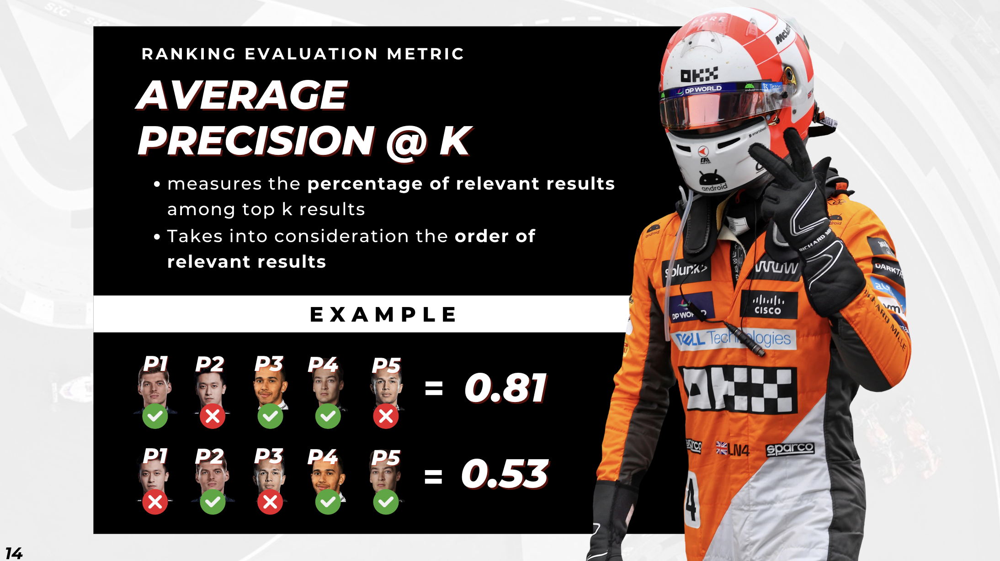

In [231]:
def average_precision_at_k(true_ranking, predicted_ranking, k_at=10):
    # Truncate the rankings at k
    k = np.sum(true_ranking <= k_at)
    top_k_predictions = predicted_ranking.index[:k]
    
    # Initialize variables to keep track of hits and calculate precision
    hits = 0
    sum_precision = 0
    
    # Iterate over the top k predicted rankings
    for i, predicted_driver in enumerate(top_k_predictions, start=1):
        # Check if the predicted driver is in the true rankings' top k
        if predicted_driver in true_ranking.index[:k]:
            hits += 1
            precision_at_i = hits / i
            sum_precision += precision_at_i
            
    # If there are no hits, the average precision is 0
    if hits == 0:
        return 0
    
    # Calculate average precision
    average_precision = sum_precision / k
    return average_precision

# **Qualifying Position as Baseline**

In [243]:
baseline = {}
total = {}
for race in range(1106, 1121):
    baseline[race] = {}
    for driver, df in dataset.items():
        if race in df.index:
            y_true = df.at[race, 'positionOrder']
            y_pred = df.at[race, 'qualifyingPosition']
            baseline[race][driver] = {
                'True': y_true,
                'Pred': y_pred
            }
        else:
            pass
    results_df = pd.DataFrame(baseline[race]).T
    total[race] = results_df

In [244]:
baseline_apak = {}
for n in range(1106,1121):
    true = total[n]['True'].sort_values()
    pred = total[n]['Pred'].sort_values()
    driver_true = df_drivers.loc[true.index]['driverId']
    driver_pred = df_drivers.loc[pred.index]['driverId']
    prec = average_precision_at_k(true, pred, k_at=10)
    baseline_apak[n] = prec
baseline_mapak = {}
for n in range(1106,1121):
    apak_val = []
    for k, v in baseline_apak.items():
        if k >= n:
            apak_val.append(v)
    baseline_mapak[n] = np.mean(apak_val)
print('MAP@K Using Qualifying as Prediction:', np.mean([v for k, v in baseline_mapak.items()]))

MAP@K Using Qualifying as Prediction: 0.7207495262029434


# **Walk Forward as Baseline**

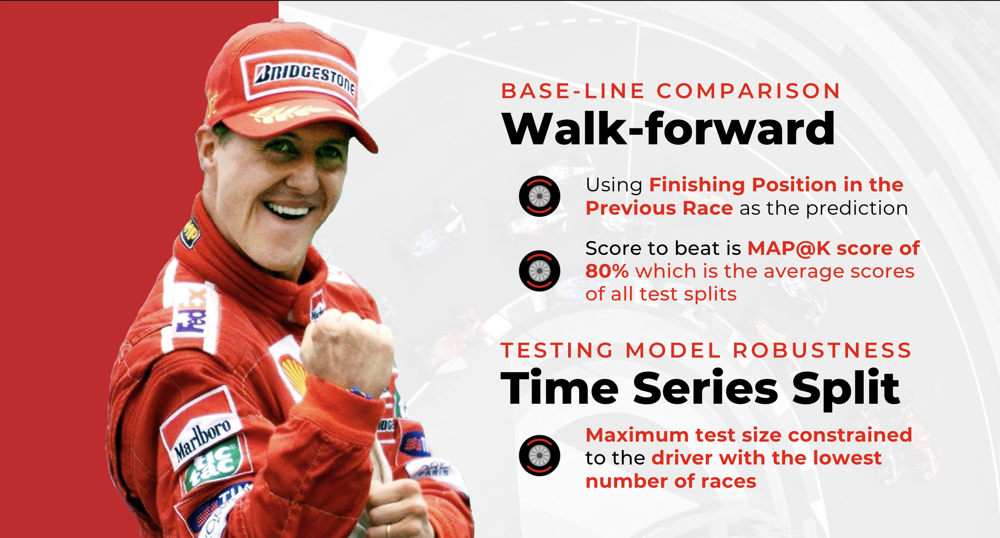

In [245]:
baseline = {}
total = {}
wf_dataset = {}
for driver, df in dataset.items():
    df_copy = df.copy()
    df_copy['Pred'] = df_copy['positionOrder'].shift(1)
    wf_dataset[driver] = df_copy.dropna()

for race in range(1106, 1121):
    baseline[race] = {}
    for driver, df in wf_dataset.items():
        if race in df.index:
            y_true = df.at[race, 'positionOrder']
            y_pred = df.at[race, 'Pred']
            baseline[race][driver] = {
                'True': y_true,
                'Pred': y_pred
            }
        else:
            pass
    results_df = pd.DataFrame(baseline[race]).T
    total[race] = results_df

In [246]:
baseline_apak = {}
for n in range(1106,1121):
    true = total[n]['True'].sort_values()
    pred = total[n]['Pred'].sort_values()
    driver_true = df_drivers.loc[true.index]['driverId']
    driver_pred = df_drivers.loc[pred.index]['driverId']
    prec = average_precision_at_k(true, pred, k_at=10)
    baseline_apak[n] = prec
baseline_mapak = {}
for n in range(1106,1121):
    apak_val = []
    for k, v in baseline_apak.items():
        if k >= n:
            apak_val.append(v)
    baseline_mapak[n] = np.mean(apak_val)
print('MAP@K Using Walk Forward as Prediction:', np.mean([v for k, v in baseline_mapak.items()]))

MAP@K Using Walk Forward as Prediction: 0.7983790303334396


<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">SELECTING THE BEST MODEL</h1><a id='ExecSum'></a><a id='Title'></a><a

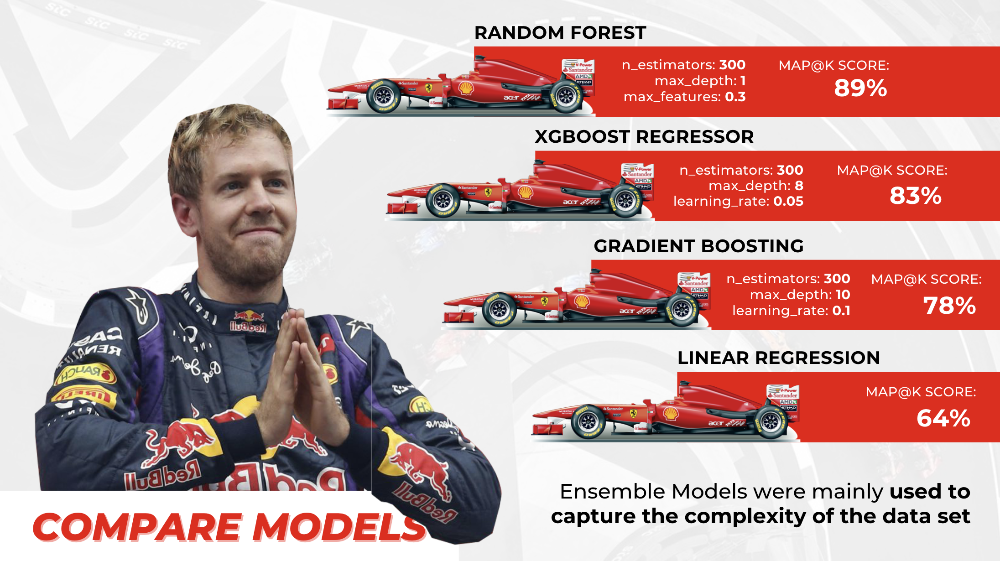

# **Linear Regression**

In [276]:
lr_dict = {}
total_pred = {}
for race in range(1106, 1121):
    lr_dict[race] = {}
    for driver, df in dataset.items():
        if race in df.index:
            df_features = df.drop(columns=['positionOrder'])
            df_target = df['positionOrder']
            X_holdout, y_holdout = df_features.loc[race:], df_target.loc[race:]
            X_train, y_train = df_features.loc[:race-1], df_target.loc[:race-1]
            test_race = X_holdout.loc[race:race]
            lr = LinearRegression(n_jobs=-1)
            lr.fit(X_train, y_train)
            lr_res = lr.predict(test_race)
            lr_dict[race][driver] = {
                'X_train': X_train,
                'X_test': X_holdout.loc[race].to_numpy().reshape(1,-1),
                'model': lr,
                'Pred': lr_res[0],
                'True': y_holdout[race]
            }
        else:
            pass
        
    results_df = pd.DataFrame(lr_dict[race], index=['Pred', 'True']).T
    total_pred[race] = results_df

In [303]:
lr_apak = {}
for n in range(1106,1121):
    true = total_pred[n]['True'].sort_values()
    pred = total_pred[n]['Pred'].sort_values()
    driver_true = df_drivers.loc[true.index]['driverId']
    driver_pred = df_drivers.loc[pred.index]['driverId']
    prec = average_precision_at_k(true, pred, k_at=10)
    lr_apak[n] = prec
lr_mapak = {}
for n in range(1106,1121):
    apak_val = []
    for k, v in lr_apak.items():
        if k >= n:
            apak_val.append(v)
    lr_mapak[n] = np.mean(apak_val)
np.mean([v for k, v in lr_mapak.items()])

0.6414258456702681

# **Gradient Boosting Regressors**

In [305]:
def gridsearch_gb(model, parameters):
    model_dict = {}
    for d, r in parameters:
        params = (d, r)
        model_dict[params] = {}
        model_apak = {}
        for race in range(1106, 1121):
            model_dict[params][race] = {}
            
            for driver, df in dataset.items():
                if race in df.index:
                    df_features = df.drop(columns=['positionOrder'])
                    df_target = df['positionOrder']
                    X_holdout, y_holdout = df_features.loc[race:], df_target.loc[race:]
                    X_train, y_train = df_features.loc[:race-1], df_target.loc[:race-1]
                    test_race = X_holdout.loc[race:race]
                    mod = model(random_state=0, n_estimators=300, max_depth=d, learning_rate=r)
                    mod.fit(X_train, y_train)
                    model_res = mod.predict(test_race)
                    model_dict[params][race][driver] = {
                        'Pred': model_res[0],
                        'True': y_holdout[race]
                    }
                else:
                    pass
            results_df = pd.DataFrame(model_dict[params][race], index=['Pred', 'True']).T
            true = results_df['True'].sort_values()
            pred = results_df['Pred'].sort_values()
            prec = average_precision_at_k(true, pred, k_at=10)
            model_apak[race] = prec
        model_mapak = {}
        for n in range(1106, 1121):
            apak_val = []
            for k, v in model_apak.items():
                if k >= n:
                    apak_val.append(v)
            model_mapak[n] = np.mean(apak_val)
        model_dict[params]['apak'] = model_apak
        model_dict[params]['mapak'] = model_mapak
        model_dict[params]['model_score'] = np.mean([v for k, v in model_mapak.items()])
    return model_dict

In [307]:
max_depth_range = [8, 10, 12]
learning_rate_range = [0.01, 0.05, 0.1]
param = product(max_depth_range, learning_rate_range)
GBM_results = gridsearch_gb(GradientBoostingRegressor, param)
for param in GBM_results.keys():
    print(f"GBM - {param} - {GBM_results[param]['model_score']}")

GBM - (8, 0.01) - 0.75334847981971
GBM - (8, 0.05) - 0.7549921537171757
GBM - (8, 0.1) - 0.7609597794776586
GBM - (10, 0.01) - 0.7517019522731823
GBM - (10, 0.05) - 0.7549921537171757
GBM - (10, 0.1) - 0.7609597794776586
GBM - (12, 0.01) - 0.7517019522731823
GBM - (12, 0.05) - 0.7549921537171757
GBM - (12, 0.1) - 0.7609597794776586


# **XGBoost Regressor**

In [308]:
max_depth_range = [8, 10, 12]
learning_rate_range = [0.01, 0.05, 0.1]
param = product(max_depth_range, learning_rate_range)
XGB_results = gridsearch_gb(XGBRegressor, param)
for param in XGB_results.keys():
    print(f"XGB - {param} - {XGB_results[param]['model_score']}")

XGB - (8, 0.01) - 0.8082055057384643
XGB - (8, 0.05) - 0.7908861540510571
XGB - (8, 0.1) - 0.7984603317252348
XGB - (10, 0.01) - 0.8076618826948414
XGB - (10, 0.05) - 0.7908861540510571
XGB - (10, 0.1) - 0.7980158872807903
XGB - (12, 0.01) - 0.8076618826948414
XGB - (12, 0.05) - 0.7908861540510571
XGB - (12, 0.1) - 0.7980158872807903


# **Random Forest Regressor**

In [309]:
def gridsearch_rf(model, parameters):
    model_dict = {}
    for d, f in parameters:
        params = (d, f)
        model_dict[params] = {}
        model_apak = {}
        for race in range(1106, 1121):
            model_dict[params][race] = {}
            for driver, df in dataset.items():
                if race in df.index:
                    df_features = df.drop(columns=['positionOrder'])
                    df_target = df['positionOrder']
                    X_holdout, y_holdout = df_features.loc[race:], df_target.loc[race:]
                    X_train, y_train = df_features.loc[:race-1], df_target.loc[:race-1]
                    test_race = X_holdout.loc[race:race]
                    mod = model(random_state=0, n_estimators=300, max_depth=d, max_features=f)
                    mod.fit(X_train, y_train)
                    model_res = mod.predict(test_race)
                    model_dict[params][race][driver] = {
                        # 'X_train': X_train,
                        # 'X_test': X_holdout.loc[race].to_numpy().reshape(1,-1),
                        # 'model': model,
                        'Pred': model_res[0],
                        'True': y_holdout[race]
                    }
                else:
                    pass
            results_df = pd.DataFrame(model_dict[params][race], index=['Pred', 'True']).T
            # model_dict[model][params][race][total_pred] = results_df
            true = results_df['True'].sort_values()
            pred = results_df['Pred'].sort_values()
            # driver_true = df_drivers.loc[true.index]['driverId']
            # driver_pred = df_drivers.loc[pred.index]['driverId']
            prec = average_precision_at_k(true, pred, k_at=10)
            model_apak[race] = prec
        model_mapak = {}
        for n in range(1106, 1121):
            apak_val = []
            for k, v in model_apak.items():
                if k >= n:
                    apak_val.append(v)
            model_mapak[n] = np.mean(apak_val)
        model_dict[params]['apak'] = model_apak
        model_dict[params]['mapak'] = model_mapak
        model_dict[params]['model_score'] = np.mean([v for k, v in model_mapak.items()])
    return model_dict

In [310]:
max_depth_range = [1, 2, 3, 4, 5, 6, 7, 8]
max_features_range = [0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, None]
param = product(max_depth_range, max_features_range)
RF_results = gridsearch_rf(RandomForestRegressor, param)
for param in RF_results.keys():
    print(f"RF - {param} - {RF_results[param]['model_score']}")

RF - (1, 0.2) - 0.8882130540176395
RF - (1, 0.25) - 0.8871839743010598
RF - (1, 0.3) - 0.8901567081515716
RF - (1, 0.35) - 0.8901567081515716
RF - (1, 0.4) - 0.8756917786366422
RF - (1, 0.5) - 0.8756995535777502
RF - (1, 0.6) - 0.8773363221589633
RF - (1, 0.7) - 0.8755009038735451
RF - (1, 0.8) - 0.8755009038735451
RF - (1, 0.9) - 0.8660800782485527
RF - (1, None) - 0.8660800782485527
RF - (2, 0.2) - 0.8861123872232999
RF - (2, 0.25) - 0.8685995798660482
RF - (2, 0.3) - 0.8734351815300448
RF - (2, 0.35) - 0.8720883452387641
RF - (2, 0.4) - 0.8734351815300448
RF - (2, 0.5) - 0.8713257498095022
RF - (2, 0.6) - 0.8581065560403084
RF - (2, 0.7) - 0.8578166237503762
RF - (2, 0.8) - 0.8581065560403084
RF - (2, 0.9) - 0.8579923143149556
RF - (2, None) - 0.8565113952340365
RF - (3, 0.2) - 0.8710575272684399
RF - (3, 0.25) - 0.866032371559951
RF - (3, 0.3) - 0.8715588757142331
RF - (3, 0.35) - 0.8670223019998815
RF - (3, 0.4) - 0.8666519316295112
RF - (3, 0.5) - 0.8710086363673887
RF - (3, 0.6)

# **Best Model: Random Forest**

In [379]:
rf_dict = {}
total_pred = {}
for race in range(1106, 1121):
    rf_dict[race] = {}
    for driver, df in dataset.items():
        if race in df.index:
            df_features = df.drop(columns=['positionOrder'])
            df_target = df['positionOrder']
            X_holdout, y_holdout = df_features.loc[race:], df_target.loc[race:]
            X_train, y_train = df_features.loc[:race-1], df_target.loc[:race-1]
            test_race = X_holdout.loc[race:race]
            rf = RandomForestRegressor(random_state=0, n_estimators=300, max_depth=1, max_features=0.3)
            rf.fit(X_train, y_train)
            rf_res = rf.predict(test_race)
            rf_dict[race][driver] = {
                'X_train': X_train,
                'X_test': X_holdout.loc[race].to_numpy().reshape(1,-1),
                'y_train': y_train,
                'model': rf,
                'Pred': rf_res[0],
                'True': y_holdout[race]
            }
        else:
            pass
    results_df = pd.DataFrame(rf_dict[race], index=['Pred', 'True']).T
    total_pred[race] = results_df

In [380]:
rf_apak = {}
for n in range(1106,1121):
    true = total_pred[n]['True'].sort_values()
    pred = total_pred[n]['Pred'].sort_values()
    driver_true = df_drivers.loc[true.index]['driverId']
    driver_pred = df_drivers.loc[pred.index]['driverId']
    prec = average_precision_at_k(true, pred, k_at=10)
    rf_apak[n] = prec
rf_mapak = {}
for n in range(1106,1121):
    apak_val = []
    for k, v in rf_apak.items():
        if k >= n:
            apak_val.append(v)
    rf_mapak[n] = np.mean(apak_val)
np.mean([v for k, v in rf_mapak.items()])

0.8901567081515716

In [381]:
for r, apak in rf_apak.items():
    print(f'Race {r}: {apak}')
    display(total_pred[r].sort_values('Pred'))

Race 1106: 0.8


,Pred,True
max_verstappen,1.901648,1.0
hamilton,4.001225,3.0
perez,4.340621,6.0
alonso,4.829949,2.0
sainz,4.917202,5.0
leclerc,5.067397,4.0
stroll,7.976555,9.0
ocon,8.226313,8.0
norris,10.818541,13.0
gasly,12.109408,12.0


Race 1107: 0.89


,Pred,True
max_verstappen,2.653056,1.0
hamilton,3.605069,8.0
alonso,4.255145,5.0
russell,4.706496,7.0
sainz,4.865793,6.0
leclerc,6.324450,2.0
perez,7.471184,3.0
stroll,8.579931,9.0
ocon,8.594517,14.0
gasly,10.654344,10.0


Race 1108: 0.8788888888888889


,Pred,True
max_verstappen,1.631614,1.0
perez,3.702136,6.0
russell,4.212951,5.0
leclerc,4.379740,9.0
hamilton,4.555852,3.0
alonso,4.740005,7.0
sainz,5.028758,10.0
stroll,8.454106,14.0
norris,9.631422,2.0
albon,12.055091,8.0


Race 1109: 1.0


,Pred,True
max_verstappen,1.727378,1.0
perez,3.773829,3.0
hamilton,4.016288,4.0
russell,4.920556,6.0
alonso,5.190402,9.0
leclerc,5.506711,7.0
sainz,5.810994,8.0
norris,9.171206,2.0
stroll,10.020682,10.0
piastri,11.486667,5.0


Race 1110: 0.9


,Pred,True
max_verstappen,1.405250,1.0
perez,3.320605,2.0
hamilton,3.826381,4.0
russell,4.496476,6.0
leclerc,5.069452,3.0
alonso,6.085751,5.0
norris,7.823067,7.0
ocon,8.902616,8.0
stroll,9.674910,9.0
ricciardo,11.355736,16.0


Race 1111: 0.7254365079365078


,Pred,True
max_verstappen,1.441853,1.0
perez,3.599147,4.0
hamilton,4.135026,6.0
russell,4.464383,17.0
alonso,5.305211,2.0
sainz,6.207575,5.0
norris,8.238506,7.0
ocon,8.991944,10.0
piastri,9.394167,9.0
stroll,9.561552,11.0


Race 1112: 0.89


,Pred,True
max_verstappen,1.683697,1.0
perez,3.430809,2.0
leclerc,4.642733,4.0
hamilton,4.927265,6.0
alonso,5.250420,9.0
sainz,5.412349,3.0
russell,5.833201,5.0
norris,8.416886,8.0
piastri,9.507889,12.0
albon,10.797092,7.0


Race 1113: 0.8467813051146383


,Pred,True
max_verstappen,1.739011,5.0
perez,3.397150,8.0
hamilton,3.925009,3.0
leclerc,4.795662,4.0
sainz,4.806842,1.0
alonso,5.864808,15.0
norris,8.127392,2.0
piastri,10.222611,7.0
gasly,10.863774,6.0
albon,11.323749,11.0


Race 1114: 1.0


,Pred,True
max_verstappen,1.829120,1.0
hamilton,4.062278,5.0
sainz,4.536944,6.0
leclerc,5.005729,4.0
russell,5.242508,7.0
norris,7.438562,2.0
alonso,7.979956,8.0
ocon,8.718258,9.0
piastri,8.914190,3.0
gasly,10.354248,10.0


Race 1115: 0.8


,Pred,True
max_verstappen,1.775258,1.0
perez,3.750420,10.0
leclerc,4.616328,5.0
russell,6.242922,4.0
alonso,7.632845,6.0
ocon,7.839632,7.0
piastri,7.881786,2.0
norris,8.103332,3.0
gasly,10.319372,12.0
stroll,11.270883,11.0


Race 1116: 0.7675


,Pred,True
max_verstappen,2.610072,1.0
perez,4.207942,4.0
sainz,4.555617,3.0
russell,5.222301,5.0
norris,7.112107,2.0
gasly,10.074553,6.0
ricciardo,10.701271,15.0
stroll,10.814841,7.0
bottas,11.796761,12.0
albon,11.823201,9.0


Race 1117: 0.89


,Pred,True
max_verstappen,2.545868,1.0
leclerc,4.019793,3.0
sainz,4.206026,4.0
hamilton,4.357683,2.0
russell,4.901720,6.0
piastri,6.897978,8.0
norris,7.862743,5.0
ocon,8.732770,10.0
gasly,10.581530,11.0
ricciardo,10.847963,7.0


Race 1118: 0.8788888888888889


,Pred,True
max_verstappen,1.640751,1.0
perez,3.992255,4.0
hamilton,4.225149,8.0
sainz,4.778913,6.0
alonso,6.406589,3.0
norris,7.403923,2.0
ocon,8.699579,10.0
piastri,9.145672,14.0
stroll,9.635080,5.0
gasly,10.327116,7.0


Race 1119: 1.0


,Pred,True
max_verstappen,1.840625,1.0
leclerc,3.945670,2.0
perez,4.228172,3.0
hamilton,4.238021,7.0
sainz,4.553108,6.0
russell,5.142239,8.0
alonso,6.622336,9.0
ocon,8.667166,4.0
piastri,9.392833,10.0
stroll,9.782503,5.0


Race 1120: 0.89


,Pred,True
max_verstappen,1.614350,1.0
perez,3.836478,4.0
leclerc,3.840098,2.0
hamilton,4.971828,9.0
piastri,5.885537,6.0
russell,5.945060,3.0
norris,6.367747,5.0
alonso,7.469240,7.0
ocon,8.443414,12.0
stroll,9.075599,10.0


<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">MODEL EXPLAINABILITY</h1><a id='ExecSum'></a><a id='Title'></a><a

# **SHAP Explainability**

In [382]:
rf_dict[1106]['hamilton']['Pred']

4.001224574631307

In [387]:
shap_dict = {}
model_dict = rf_dict
for n in model_dict.keys():
    shap_dict[n] = {}
    for driver, df in dataset.items():
        if n in df.index:
            train = model_dict[n][driver]['X_train']
            test = model_dict[n][driver]['X_test']
            model = model_dict[n][driver]['model']
            shap_explainer = shap.Explainer(model.predict, train, 
                                            feature_names=train.columns.tolist(), 
                                            seed=0)
            shap_values = shap_explainer(test)
            shap_explanation = shap.Explanation(
                shap_values.values[0],
                shap_values.base_values[0],
                shap_values.data[0],
                feature_names=train.columns.tolist()
            )
            shap_dict[n][driver] = {
                'explainer': shap_explainer,
                'shap_values': shap_values,
                'shap_explanation': shap_explanation
            }
            

gasly 13


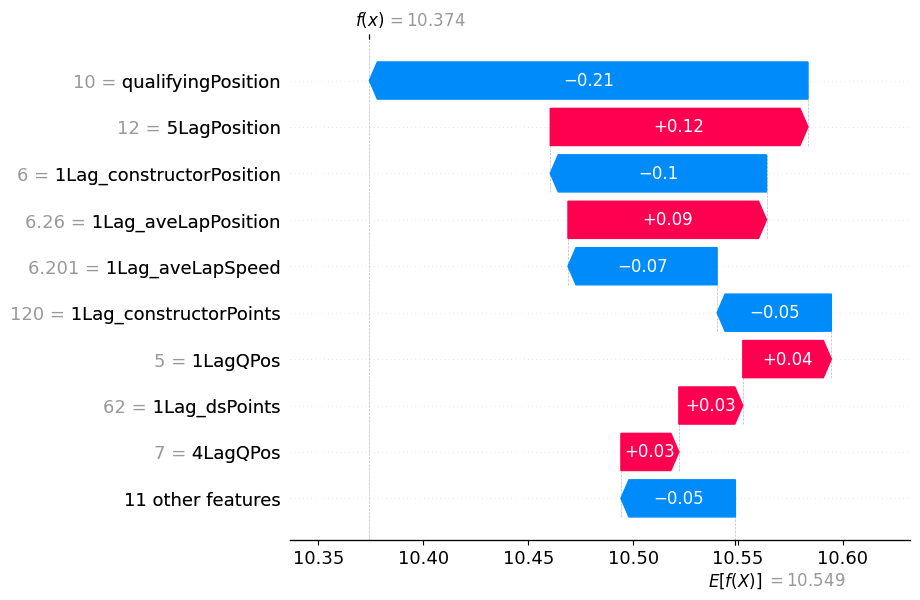

In [327]:
driver = 'gasly'
n = 1120

print(driver, model_dict[n][driver]['True'])
shap.plots.waterfall(shap_dict[n][driver]['shap_explanation'])

In [389]:
shap.initjs()

gasly 13


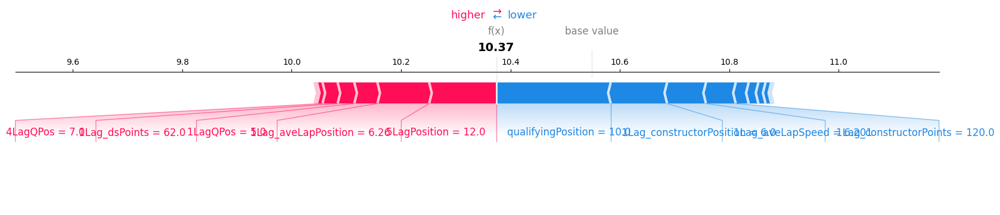

In [401]:
driver = 'gasly'
n = 1120

print(driver, model_dict[n][driver]['True'])

# Initialize SHAP JS for visualizations
shap.initjs()

# Render SHAP force plot with the white background
shap.plots.force(shap_dict[n][driver]['shap_explanation'], matplotlib=True)

# **LIME**

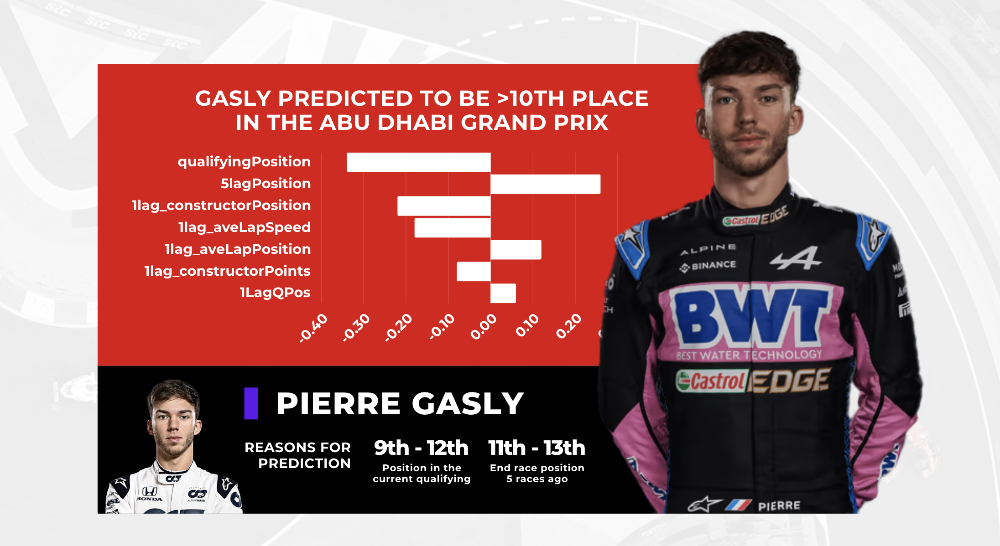

In [417]:
lime_dict = {}

for n in model_dict.keys():
    lime_dict[n] = {}
    for driver, df in dataset.items(): 
        if n in df.index:
            train = model_dict[n][driver]['X_train']
            test = model_dict[n][driver]['X_test']
            model = model_dict[n][driver]['model']
            lime_explainer = LimeTabularExplainer(train.values,
                                                  feature_names=train.columns.tolist(),
                                                  verbose=False,
                                                  mode='regression',
                                                  random_state=0)
            lime_explanation = lime_explainer.explain_instance(test.reshape(-1), model.predict)
            lime_dict[n][driver] = {
                'lime_explainer': lime_explainer,
                'lime_explanation': lime_explanation
            }

/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/

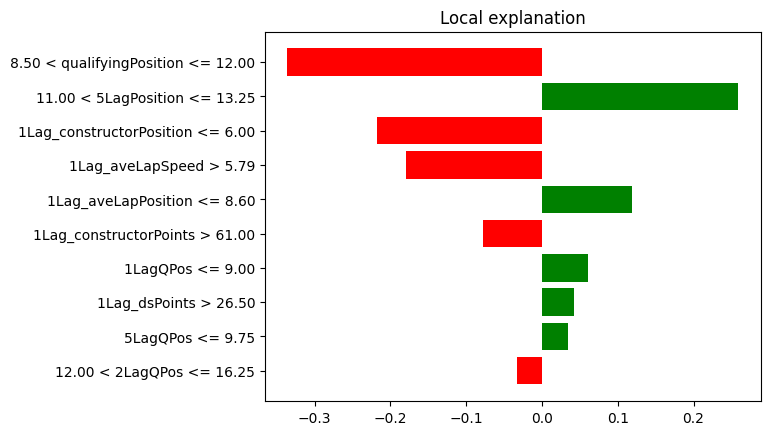

In [328]:
# Set the figure background to white before displaying the LIME explanation
fig = lime_dict[n][driver]['lime_explanation'].as_pyplot_figure()

# Set white background for the figure
fig.patch.set_facecolor('white')
plt.gcf().set_facecolor('white')

# Show the figure with white background
plt.show()

# **DICE**

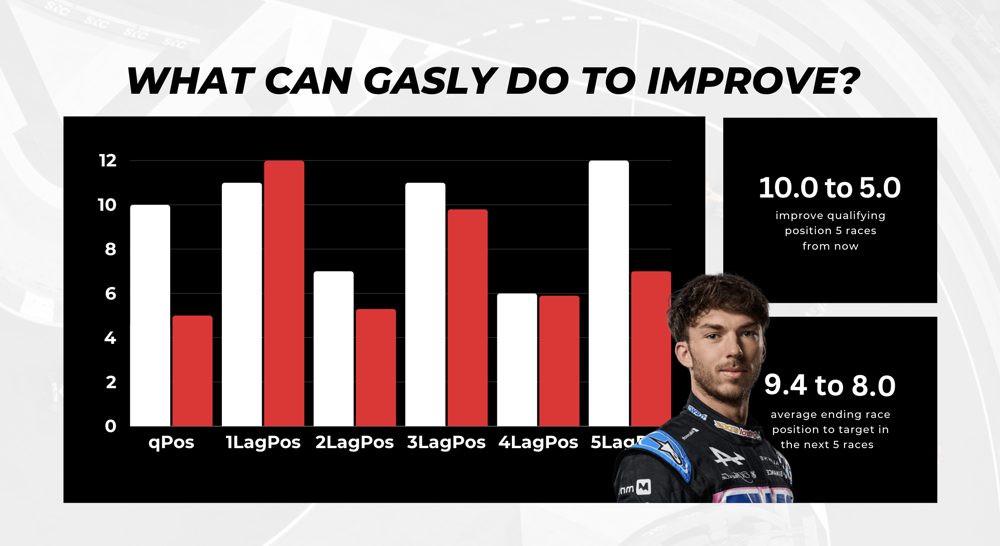

In [318]:
dice_dict = {}
model_dict = rf_dict
for n in model_dict.keys():
    dice_dict[n] = {}
    for driver, df in dataset.items():
        if n in df.index:
            model = model_dict[n][driver]['model']
            X_train = model_dict[n][driver]['X_train']
            y_train = model_dict[n][driver]['y_train']
            test = model_dict[n][driver]['X_test']
            dice_model = Model(model=model, backend='sklearn', model_type='regressor')
            dice_data = Data(
                dataframe=X_train.join(y_train),
                continuous_features=X_train.columns.tolist(),
                outcome_name='positionOrder')
            dice_exp = Dice(dice_data, dice_model, method='genetic')
            
            dice_dict[n][driver] = {
                'explainer': dice_exp,
                'test': test
            }

In [410]:
driver = 'gasly'
n = 1120
X = model_dict[n][driver]['X_train']
cfes1 = dice_dict[n][driver]['explainer'].generate_counterfactuals(
    pd.DataFrame(dice_dict[n][driver]['test'], columns=X.columns.tolist()),
    total_CFs=5,
    desired_range=[9, 10],
    features_to_vary=[
        # '1Lag_aveLapSpeed',
        'qualifyingPosition',
         '1LagPosition',
         '2LagPosition',
         '3LagPosition',
         '4LagPosition',
         '5LagPosition',
         # '1LagQPos',
         # '2LagQPos',
         # '3LagQPos',
         # '4LagQPos',
         # '5LagQPos'
                     ]
)

100%|██████████| 1/1 [00:00<00:00,  1.18it/s]


In [411]:
cfes1.visualize_as_dataframe(show_only_changes=True)

Query instance (original outcome : 10.374239921569824)


,1Lag_dsPoints,1Lag_dsPosition,1Lag_driverWins,1Lag_constructorPoints,1Lag_constructorPosition,1Lag_constructorWins,1Lag_aveLapPosition,1Lag_aveLapSpeed,1Lag_fastestLapRank,qualifyingPosition,...,2LagPosition,3LagPosition,4LagPosition,5LagPosition,1LagQPos,2LagQPos,3LagQPos,4LagQPos,5LagQPos,positionOrder
0,62.0,11.0,0.0,120.0,6.0,0.0,6.26,6.201,11.0,10.0,...,7.0,11.0,6.0,12.0,5.0,13.0,11.0,7.0,7.0,10.37424



Diverse Counterfactual set (new outcome: [9, 10])


,1Lag_dsPoints,1Lag_dsPosition,1Lag_driverWins,1Lag_constructorPoints,1Lag_constructorPosition,1Lag_constructorWins,1Lag_aveLapPosition,1Lag_aveLapSpeed,1Lag_fastestLapRank,qualifyingPosition,...,2LagPosition,3LagPosition,4LagPosition,5LagPosition,1LagQPos,2LagQPos,3LagQPos,4LagQPos,5LagQPos,positionOrder
0,-,-,-,-,-,-,-,-,-,13.0,...,6.0,12.0,10.0,6.0,-,-,-,-,-,9.768222480170007
0,-,-,-,-,-,-,-,-,-,-,...,7.3,16.1,4.7,6.2,-,-,-,-,-,9.668852213895049
0,-,-,-,-,-,-,-,-,-,5.0,...,7.7,12.0,9.0,3.0,-,-,-,-,-,9.502605872423743
0,-,-,-,-,-,-,-,-,-,5.0,...,13.0,12.0,7.0,4.0,-,-,-,-,-,9.491963004824354
0,-,-,-,-,-,-,-,-,-,5.0,...,13.0,12.0,7.0,3.9,-,-,-,-,-,9.491963004824354


In [330]:
cfes1.visualize_as_list(show_only_changes=True)

Query instance (original outcome : 10.374239921569824)
[62.0, 11.0, 0.0, 120.0, 6.0, 0.0, 6.260000228881836, 6.201000213623047, 11.0, 10.0, 11.0, 7.0, 11.0, 6.0, 12.0, 5.0, 13.0, 11.0, 7.0, 7.0, 10.374239921569824]

Diverse Counterfactual set (new outcome: [9, 10])
['-', '-', '-', '-', '-', '-', '-', '-', '-', 13.0, '-', 6.0, 12.0, 10.0, 6.0, '-', '-', '-', '-', '-', 9.768222480170007]
['-', '-', '-', '-', '-', '-', '-', '-', '-', '-', 12.3, 7.3, 16.1, 4.7, 6.2, '-', '-', '-', '-', '-', 9.668852213895049]
['-', '-', '-', '-', '-', '-', '-', '-', '-', 6.0, '-', 13.0, 12.0, 9.0, 6.5, '-', '-', '-', '-', '-', 9.509701100062449]
['-', '-', '-', '-', '-', '-', '-', '-', '-', 6.0, 14.3, 4.3, 10.7, 6.3, 7.1, '-', '-', '-', '-', '-', 9.56628731133392]
['-', '-', '-', '-', '-', '-', '-', '-', '-', 6.0, 14.3, 4.3, 10.4, 6.3, 6.8, '-', '-', '-', '-', '-', 9.548756447136387]


<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">PREDICT FIRST RACE OF 2024: BAHRAIN</h1><a id='ExecSum'></a><a id='Title'></a><a

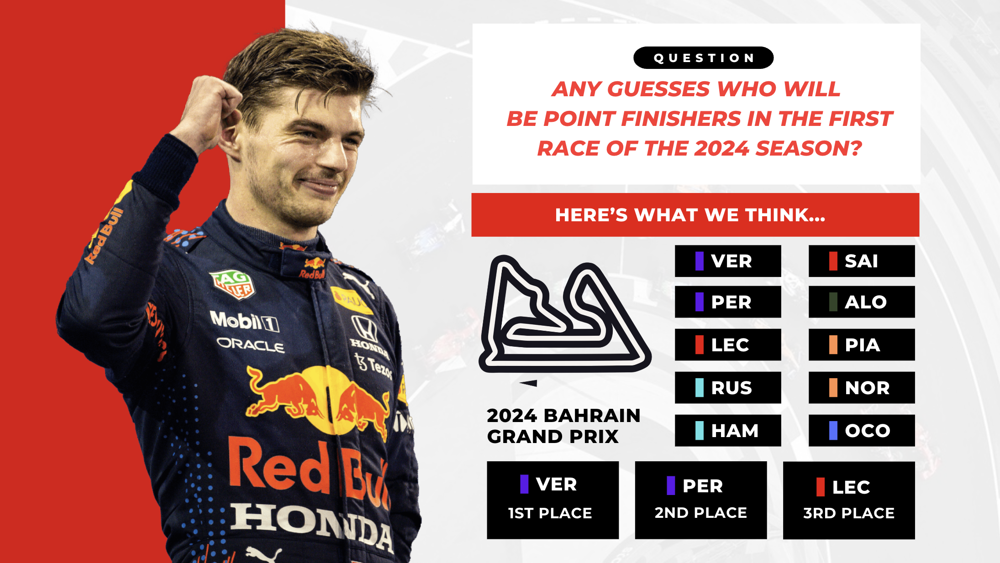

In [419]:
def create_bahrain_test(df):
    df['fastestLapRank'] = pd.to_numeric(df['fastestLapRank'])
    if any(np.isnan(df['aveLapPosition'])):
        idx = np.where(np.isnan(df['aveLapPosition']))[0]
        for i in idx:
            df.iloc[i,23] = df.iloc[i,15]
    if any(np.isnan(df['aveLapSpeed'])):
        idx = np.where(np.isnan(df['aveLapSpeed']))[0]
        for i in idx:
            df.iloc[i,24] = df.iloc[i,-1]
    df_race = df.sort_index()
    df_race.loc['bahrain'] = np.nan
    for i in range(1,6):
        df_race[str(i)+'LagPosition'] = df_race['positionOrder'].shift(i)
        df_race[str(i)+'LagQPos'] = df_race['qualifyingPosition'].shift(i)
    df_race[
        [
            '1Lag_dsPoints',
            '1Lag_dsPosition',
            '1Lag_driverWins',
            '1Lag_constructorPoints',
            '1Lag_constructorPosition',
            '1Lag_constructorWins',
            '1Lag_aveLapPosition',
            '1Lag_aveLapSpeed',
            '1Lag_fastestLapRank'
        ]
    ] = df_race[
        [
            'dsPoints',
            'dsPosition',
            'driverWins',
            'constructorPoints',
            'constructorPosition',
            'constructorWins',
            'aveLapPosition',
            'aveLapSpeed',
            'fastestLapRank'
        ]
    ].shift(1)
    
    qualPos = {
        'hamilton': 9,
        'alonso': 6,
        'gasly': 20,
        'hulkenberg': 10,
        'perez': 5,
        'ricciardo': 14,
        'bottas': 16,
        'kevin_magnussen': 15,
        'max_verstappen': 1,
        'sainz': 4,
        'ocon': 19,
        'stroll': 12,
        'leclerc': 2,
        'norris': 7,
        'russell': 3,
        'albon': 13,
        'tsunoda': 11,
        'zhou': 17,
        'piastri': 8,
        'sargeant': 18
    }
    
    df_race.at['bahrain', 'qualifyingPosition'] = qualPos[driver]
    
    return df_race.loc['bahrain', [
            '1Lag_dsPoints',
            '1Lag_dsPosition',
            '1Lag_driverWins',
            '1Lag_constructorPoints',
            '1Lag_constructorPosition',
            '1Lag_constructorWins',
            '1Lag_aveLapPosition',
            '1Lag_aveLapSpeed',
            '1Lag_fastestLapRank',
            'qualifyingPosition',
            # 'fpPosition',
            '1LagPosition',
            '2LagPosition',
            '3LagPosition',
            '4LagPosition',
            '5LagPosition',
            '1LagQPos',
            '2LagQPos',
            '3LagQPos',
            '4LagQPos',
            '5LagQPos'
        ]
    ]

In [439]:
bahrain_test = {}
for driver, df in driver_dict.items():
    bahrain_test[driver] = create_bahrain_test(df.copy())

In [445]:
bahrain_pred = {}
bahrain_models = {}
for driver, df in dataset.items():
    df_features = df.drop(columns=['positionOrder'])
    df_target = df['positionOrder']
    X_train, y_train = df_features, df_target
    test_race = bahrain_test[driver].to_numpy().reshape(1, -1)
    rf = RandomForestRegressor(random_state=0, n_estimators=300, max_depth=1, max_features=0.3)
    rf.fit(X_train, y_train)
    rf_res = rf.predict(test_race)
    bahrain_pred[driver] = rf_res[0]
    bahrain_models[driver] = rf
results_df = pd.DataFrame(bahrain_pred, index=['Bahrain 2024']).T.sort_values('Bahrain 2024')

/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/envs/JJ2/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/opt/anaconda3/

In [446]:
results_df['Ranking'] = range(1,21)
results_df

,Bahrain 2024,Ranking
max_verstappen,1.652261,1
perez,3.686029,2
leclerc,3.803807,3
russell,5.119083,4
hamilton,5.620226,5
sainz,5.645286,6
alonso,6.301667,7
norris,6.871832,8
piastri,7.433289,9
ocon,8.592111,10
